Exploratory Data Analysis (EDA) is a crucial step to understand and summarize the main characteristics of credit card data, identify patterns, relationships.
Including Summary Statistics and Some insightful Data Visualizations to support the analysis.

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import seaborn as sns
import matplotlib.dates as md
from matplotlib import pyplot as plt
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

### Data Checkup 

In [2]:
data = pd.read_csv("palpay data new.csv")

In [3]:
data

,Transaction Date,Card Type,Channel,Transaction Type,Transaction Type Group,Entry Mode,Transaction Status,Outlet ID,Merchant Country,Merchant Activity,Client Code,Amount USD
0,1/1/2023,Visa Classic Debit,ATM,Withdrawal,ATM Transactions,Chip & Pin,PROCESSED,110002011,Palestine,Cash withdrawal from the ATM,P00589393,-86.460
1,1/1/2023,Visa Classic Debit,ATM,Withdrawal,ATM Transactions,Chip & Pin,PROCESSED,110002011,Palestine,Cash withdrawal from the ATM,P00589393,-28.820
2,1/1/2023,Visa Classic Debit,POS,Purchase,Purchases,Chip & Pin,PROCESSED,110002413,Palestine,Supermarkets & Confectionary,P00589801,-14.409
3,1/1/2023,Visa Classic Debit,ATM,Withdrawal,ATM Transactions,Chip & Pin,PROCESSED,110002011,Palestine,Cash withdrawal from the ATM,P00565050,-317.000
4,1/1/2023,Visa Classic Debit,ATM,Withdrawal,ATM Transactions,Other,PROCESSED,800000010,Palestine,Cash withdrawal from the ATM,P00575741,-43.230
...,...,...,...,...,...,...,...,...,...,...,...,...
82629,6/30/2023,Visa Classic Debit,POS,Purchase,Purchases,Paywave,PROCESSED,310103241,Palestine,Supermarkets & Confectionary,P00357371,-5.205
82630,6/30/2023,Visa Classic Debit,ATM,Withdrawal,ATM Transactions,Other,PROCESSED,10000401,Palestine,Cash withdrawal from the ATM,P00494710,-600.000
82631,6/30/2023,Visa Classic Debit,ATM,Withdrawal,ATM Transactions,Other,PROCESSED,10000401,Palestine,Cash withdrawal from the ATM,P00352736,-1000.000
82632,6/30/2023,Visa Classic Debit,POS,Purchase,Purchases,Paywave,PROCESSED,400000936,Palestine,Entertainment & Restaurants,P00635693,-2.466


In [4]:
data['Transaction Date '] = pd.to_datetime(data['Transaction Date '])

In [5]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82634 entries, 0 to 82633
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   Transaction Date        82634 non-null  datetime64[ns]
 1   Card Type               82634 non-null  object        
 2   Channel                 82634 non-null  object        
 3   Transaction Type        82634 non-null  object        
 4   Transaction Type Group  82634 non-null  object        
 5   Entry Mode              82634 non-null  object        
 6   Transaction Status      82634 non-null  object        
 7   Outlet ID               82634 non-null  int64         
 8   Merchant Country        82634 non-null  object        
 9   Merchant Activity       82634 non-null  object        
 10  Client Code             82634 non-null  object        
 11  Amount USD              82634 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1), ob

In [6]:
data['Outlet ID'] = data['Outlet ID'].astype(str)

In [7]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82634 entries, 0 to 82633
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   Transaction Date        82634 non-null  datetime64[ns]
 1   Card Type               82634 non-null  object        
 2   Channel                 82634 non-null  object        
 3   Transaction Type        82634 non-null  object        
 4   Transaction Type Group  82634 non-null  object        
 5   Entry Mode              82634 non-null  object        
 6   Transaction Status      82634 non-null  object        
 7   Outlet ID               82634 non-null  object        
 8   Merchant Country        82634 non-null  object        
 9   Merchant Activity       82634 non-null  object        
 10  Client Code             82634 non-null  object        
 11  Amount USD              82634 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(10)
m

In [8]:
data.isnull().sum()

Transaction Date          0
Card Type                 0
Channel                   0
Transaction Type          0
Transaction Type Group    0
Entry Mode                0
Transaction Status        0
Outlet ID                 0
Merchant Country          0
Merchant Activity         0
Client Code               0
Amount USD                0
dtype: int64

### 1 Statistical analysis

In [9]:
data.describe()

,Amount USD
count,82634.000000
mean,-73.366999
std,150.260774
min,-3500.000000
25%,-85.110000
50%,-26.495000
75%,-5.580000
max,2865.330000


In [10]:
grouped_data = data.groupby('Transaction Type')

In [11]:
for transaction_type, group in grouped_data:
    print(f"Summary statistics for Transaction Type: {transaction_type}")
    print(group.describe())
    print("\n") 

Summary statistics for Transaction Type: Deposit
        Amount USD
count  2455.000000
mean    172.957116
std     301.469727
min       5.410000
25%      27.760000
50%      57.140000
75%     174.930000
max    2865.330000


Summary statistics for Transaction Type: Purchase
         Amount USD
count  44573.000000
mean     -27.614816
std       71.736800
min    -1662.048000
25%      -20.000000
50%       -8.310000
75%       -2.967000
max        8.000000


Summary statistics for Transaction Type: Withdrawal
         Amount USD
count  35606.000000
mean    -147.625207
std      165.455487
min    -3500.000000
25%     -179.000000
50%      -85.110000
75%      -55.630000
max       -1.660000




In [12]:
groupeddata = data.groupby('Transaction Status ')

In [13]:
for transaction_status, group in groupeddata:
    print(f"Summary statistics for Transaction status: {transaction_status}")
    print(group.describe())
    print("\n") 

Summary statistics for Transaction status: PROCESSED
         Amount USD
count  82633.000000
mean     -73.367984
std      150.261417
min    -3500.000000
25%      -85.110000
50%      -26.500000
75%       -5.580000
max     2865.330000


Summary statistics for Transaction status: REVERSED
       Amount USD
count         1.0
mean          8.0
std           NaN
min           8.0
25%           8.0
50%           8.0
75%           8.0
max           8.0




C:\Users\Sama Zuhd\AppData\Local\Temp\ipykernel_21060\3463849523.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['Transaction Date '])


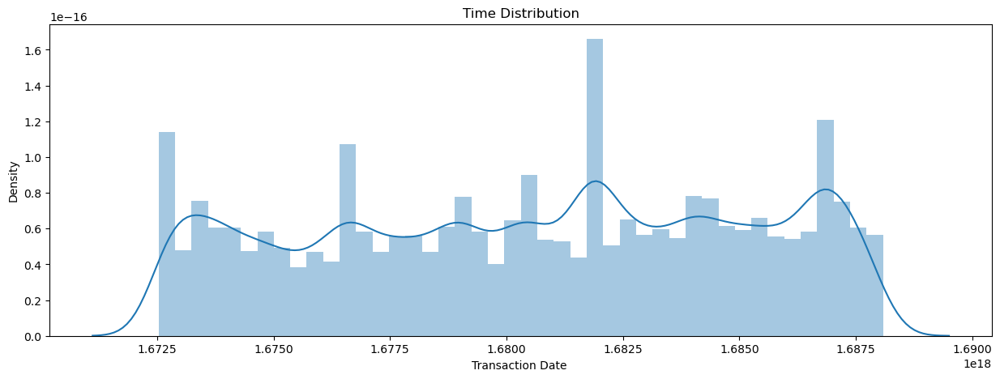

In [14]:
plt.figure(figsize=(15, 5))
plt.title('Time Distribution')
sns.distplot(data['Transaction Date ']) 
plt.show()

C:\Users\Sama Zuhd\AppData\Local\Temp\ipykernel_21060\94555847.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['Amount USD'])


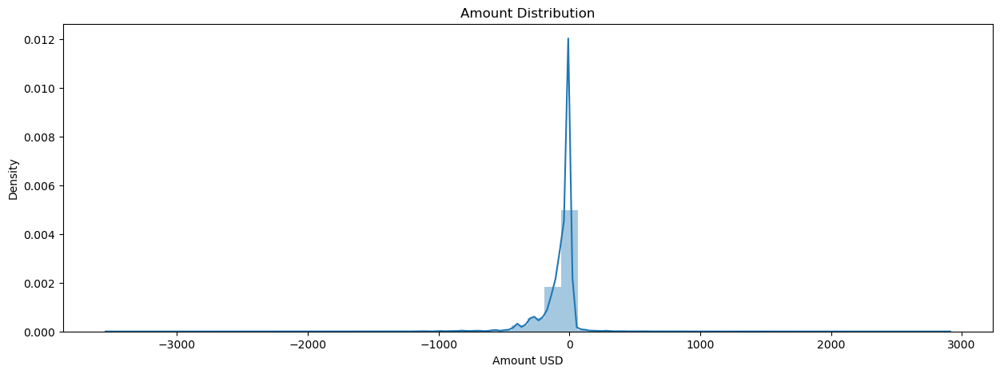

In [15]:
plt.figure(figsize=(15, 5))
plt.title('Amount Distribution')
sns.distplot(data['Amount USD']) 
plt.show()

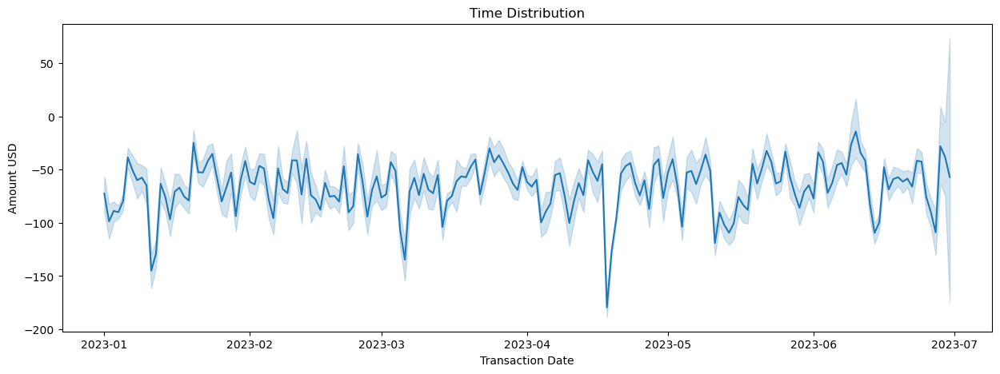

In [16]:
plt.figure(figsize=(15, 5))
plt.title('Time Distribution')
sns.lineplot(data=data, x='Transaction Date ', y='Amount USD')
plt.xlabel('Transaction Date')
plt.ylabel('Amount USD')
plt.show()

In [17]:
from dataprep.eda import plot, plot_correlation, create_report, plot_missing

100%|############################################################################################| 1/1 [00:00<…

  0%|                                                                                          | 0/336 [00:00<…


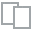
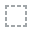
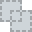
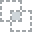
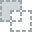
...
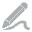
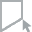
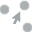
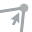
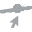

In [18]:
plot(data)

100%|############################################################################################| 1/1 [00:00<…

  0%|                                                                                         | 0/1185 [00:00<…

C:\Users\Sama Zuhd\anaconda3\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\Sama Zuhd\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Sama Zuhd\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Sama Zuhd\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.ap

DataPrep Report
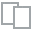
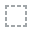
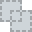
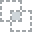
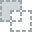
...
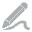
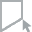
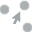
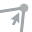
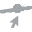

In [19]:
create_report(data)

  0%|                                                                                          | 0/123 [00:00<…


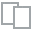
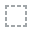
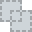
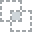
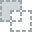
...
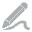
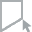
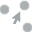
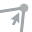
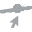

In [20]:
plot(data, "Amount USD")